# Importing Neccessary Libraries and our csv dataset as pandas dataframe

In [1]:
# Data Analysis
import pandas as pd
import numpy as np

# Data Visualization
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

# Statistics
from scipy import stats
from scipy.stats import norm
from scipy.stats import skew
from statsmodels.stats.outliers_influence import variance_inflation_factor

# Machine Learning
from sklearn import linear_model, metrics
from sklearn.feature_selection import RFE
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures, MinMaxScaler
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_squared_error, r2_score

import os

# hide warnings
import warnings
warnings.filterwarnings('ignore')

# Display all the columns of the dataframe
pd.pandas.set_option('display.max_columns',None)
pd.set_option("display.max_rows", None)


/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
fp="/content/drive/MyDrive/Colab Notebooks/IIIT Bangalore/4_MachineLearning1/CaseStudy_HousePricing/train.csv"

In [4]:
house_df=pd.read_csv(fp)
house_df.head(10)

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,NaN,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000
5,6,50,RL,85.0,14115,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,Mitchel,Norm,Norm,1Fam,1.5Fin,5,5,1993,1995,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,Wood,Gd,TA,No,GLQ,732,Unf,0,64,796,GasA,Ex,Y,SBrkr,796,566,0,1362,1,0,1,1,1,1,TA,5,Typ,0,NaN,Attchd,1993.0,Unf,2,480,TA,TA,Y,40,30,0,320,0,0,NaN,MnPrv,Shed,700,10,2009,WD,Normal,143000
6,7,20,RL,75.0,10084,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Somerst,Norm,Norm,1Fam,1Story,8,5,2004,2005,Gable,CompShg,VinylSd,VinylSd,Stone,186.0,Gd,TA,PConc,Ex,TA,Av,GLQ,1369,Unf,0,317,1686,GasA,Ex,Y,SBrkr,1694,0,0,1694,1,0,2,0,3,1,Gd,7,Typ,1,Gd,Attchd,2004.0,RFn,2,636,TA,TA,Y,255,57,0,0,0,0,NaN,NaN,NaN,0,8,2007,WD,Normal,307000
7,8,60,RL,NaN,10382,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,NWAmes,PosN,Norm,1Fam,2Story,7,6,1973,1973,Gable,CompShg,HdBoard,HdBoard,Stone,240.0,TA,TA,CBlock,Gd,TA,Mn,ALQ,859,BLQ,32,216,1107,GasA,Ex,Y,SBrkr,1107,983,0,2090,1,0,2,1,3,1,TA,7,Typ,2,TA,Attchd,1973.0,RFn,2,484,TA,TA,Y,235,204,228,0,0,0,NaN,NaN,Shed,350,11,2009,WD,Normal,200000
8,9,50,RM,51.0,6120,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Artery,Norm,1Fam,1.5Fin,7,5,1931,1950,Gable,CompShg,BrkFace,Wd Shng,None,0.0,TA,TA,BrkTil,TA,TA,No,Unf,0,Unf,0,952,952,GasA,Gd,Y,FuseF,1022,752,0,1774,0,0,2,0,2,2,TA,8,Min1,2,TA,Detchd,1931.0,Unf,2,468,Fa,TA,Y,90,0,205,0,0,0,NaN,NaN,NaN,0,4,2008,WD,Abnorml,129900
9,10,190,RL,50.0,7420,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,BrkSide,Artery,Artery,2fmCon,1.5Unf,5,6,1939,1950,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,BrkTil,TA,TA,No,GLQ,851,Unf,0,140,991,Gas

# Data quality checks 
* Removing data redundancies
* Missing value imputation

In [5]:
house_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   object 
 3   LotFrontage    1201 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   object 
 6   Alley          91 non-null     object 
 7   LotShape       1460 non-null   object 
 8   LandContour    1460 non-null   object 
 9   Utilities      1460 non-null   object 
 10  LotConfig      1460 non-null   object 
 11  LandSlope      1460 non-null   object 
 12  Neighborhood   1460 non-null   object 
 13  Condition1     1460 non-null   object 
 14  Condition2     1460 non-null   object 
 15  BldgType       1460 non-null   object 
 16  HouseStyle     1460 non-null   object 
 17  OverallQual    1460 non-null   int64  
 18  OverallC

*As we can see out of 81 some columns have null values*

**Removing Columns that have more than one-third of missing data**

In [6]:
onethird = len(house_df) // 3
print(onethird)

# boolean condition
# true if columns have more than one-third of data missing
cond_missingdata = house_df.isnull().sum() >= onethird

# list of columns have more than one-third of data missing
null_cols=[]
for i in range(len(cond_missingdata)):
  if cond_missingdata[i]:
    null_cols.append(house_df.columns[i])

# printing list of columns with missing data
null_cols

486


['Alley', 'FireplaceQu', 'PoolQC', 'Fence', 'MiscFeature']

In [7]:
for name in null_cols :
    del house_df[name]

In [8]:
# Dropping index column as it has no significance 
house_df.drop(['Id'], axis = 1,inplace=True)
house_df.head()

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,60,RL,65.0,8450,Pave,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,0,2,2008,WD,Normal,208500
1,20,RL,80.0,9600,Pave,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,0,5,2007,WD,Normal,181500
2,60,RL,68.0,11250,Pave,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,0,9,2008,WD,Normal,223500
3,70,RL,60.0,9550,Pave,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,0,2,2006,WD,Abnorml,140000
4,60,RL,84.0,14260,Pave,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,0,12,2008,WD,Normal,250000


In [9]:
house_df.shape

(1460, 75)

*We have now 75 columns to work with*

**Custom Function to build BoxPlot for all columns**

In [10]:
def plot_all_boxplot(col_list,orig_df):
  for c in col_list:
    sns.boxplot(x=c,y='SalePrice',data=orig_df)
    plt.title(c)
    plt.show()

**Custom Function to build Regplot for all columns**

In [11]:
def plot_all_regplot(col_list,orig_df):
  for c in col_list:
    df=orig_df.copy()
    sns.regplot(orig_df[c],orig_df['SalePrice'])    
    plt.xlabel(c)
    plt.ylabel('SalePrice')
    plt.title(c)
    plt.show()

**Custom Function to build Histogram for all columns**

In [12]:
def plot_all_histogram(col_list,orig_df):
  for c in col_list:
      df=orig_df.copy()
      df[c].hist(bins=30)
      plt.xlabel(col)
      plt.ylabel("Count")
      plt.title(col)
      plt.show()

**Extracting Numerical Features from whole dataset**

In [13]:
num_cols=[]
for col in house_df.columns:
  if house_df[col].dtypes != 'O':
    num_cols.append(col)

print('Number of numerical Features are',len(num_cols))
house_df[num_cols].head(10)

Number of numerical Features are 37


,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
0,60,65.0,8450,7,5,2003,2003,196.0,706,0,150,856,856,854,0,1710,1,0,2,1,3,1,8,0,2003.0,2,548,0,61,0,0,0,0,0,2,2008,208500
1,20,80.0,9600,6,8,1976,1976,0.0,978,0,284,1262,1262,0,0,1262,0,1,2,0,3,1,6,1,1976.0,2,460,298,0,0,0,0,0,0,5,2007,181500
2,60,68.0,11250,7,5,2001,2002,162.0,486,0,434,920,920,866,0,1786,1,0,2,1,3,1,6,1,2001.0,2,608,0,42,0,0,0,0,0,9,2008,223500
3,70,60.0,9550,7,5,1915,1970,0.0,216,0,540,756,961,756,0,1717,1,0,1,0,3,1,7,1,1998.0,3,642,0,35,272,0,0,0,0,2,2006,140000
4,60,84.0,14260,8,5,2000,2000,350.0,655,0,490,1145,1145,1053,0,2198,1,0,2,1,4,1,9,1,2000.0,3,836,192,84,0,0,0,0,0,12,2008,250000
5,50,85.0,14115,5,5,1993,1995,0.0,732,0,64,796,796,566,0,1362,1,0,1,1,1,1,5,0,1993.0,2,480,40,30,0,320,0,0,700,10,2009,143000
6,20,75.0,10084,8,5,2004,2005,186.0,1369,0,317,1686,1694,0,0,1694,1,0,2,0,3,1,7,1,2004.0,2,636,255,57,0,0,0,0,0,8,2007,307000
7,60,NaN,10382,7,6,1973,1973,240.0,859,32,216,1107,1107,983,0,2090,1,0,2,1,3,1,7,2,1973.0,2,484,235,204,228,0,0,0,350,11,2009,200000
8,50,51.0,6120,7,5,1931,1950,0.0,0,0,952,952,1022,752,0,1774,0,0,2,0,2,2,8,2,1931.0,2,468,90,0,205,0,0,0,0,4,2008,129900
9,190,50.0,7420,5,6,1939,1950,0.0,851,0,140,991,1077,0,0,1077,1,0,1,0,2,2,5,2,1939.0,1,205,0,4,0,0,0,0,0,1,2008,118000


**Extracting Temporal Numerical Features**

In [14]:
year_cols=[]
for col in num_cols:
  if 'Yr' in col or 'Year' in col:
    year_cols.append(col)

house_df[year_cols].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 4 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   YearBuilt     1460 non-null   int64  
 1   YearRemodAdd  1460 non-null   int64  
 2   GarageYrBlt   1379 non-null   float64
 3   YrSold        1460 non-null   int64  
dtypes: float64(1), int64(3)
memory usage: 45.8 KB


* Data quality : imputing missing values with mode
* Data redundancy : year cannot be of float data type

In [15]:
cm=house_df['GarageYrBlt'].mode()[0]
house_df['GarageYrBlt']=house_df['GarageYrBlt'].fillna(cm)
house_df[year_cols].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 4 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   YearBuilt     1460 non-null   int64  
 1   YearRemodAdd  1460 non-null   int64  
 2   GarageYrBlt   1460 non-null   float64
 3   YrSold        1460 non-null   int64  
dtypes: float64(1), int64(3)
memory usage: 45.8 KB


In [16]:
house_df['GarageYrBlt']=house_df['GarageYrBlt'].astype(int)
house_df[year_cols].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 4 columns):
 #   Column        Non-Null Count  Dtype
---  ------        --------------  -----
 0   YearBuilt     1460 non-null   int64
 1   YearRemodAdd  1460 non-null   int64
 2   GarageYrBlt   1460 non-null   int64
 3   YrSold        1460 non-null   int64
dtypes: int64(4)
memory usage: 45.8 KB


In [17]:
house_df[year_cols].head()

,YearBuilt,YearRemodAdd,GarageYrBlt,YrSold
0,2003,2003,2003,2008
1,1976,1976,1976,2007
2,2001,2002,2001,2008
3,1915,1970,1998,2006
4,2000,2000,2000,2008


**EDA : Temporal**
* Building Regression Plots for all temporal features
* Removing Outliers from all temporal features

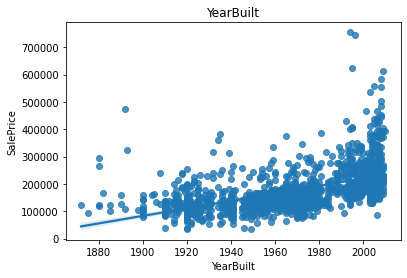

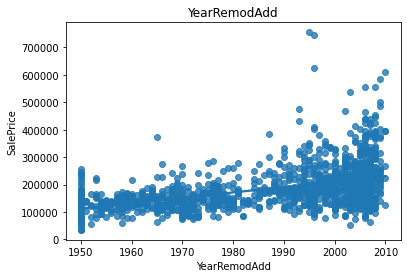

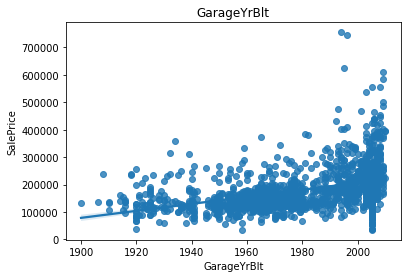

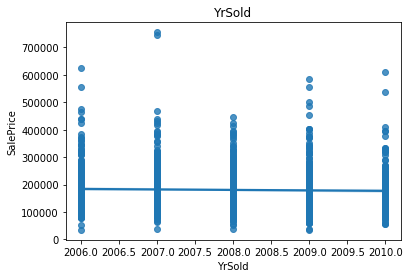

In [18]:
plot_all_regplot(year_cols,house_df)

*Removing outliers based on above plots*

* In all above graphs we have outliers for SalePrice>=600000
* Considering data only for Saleprice<600000

In [19]:
house_df=house_df[house_df['SalePrice']<600000]
house_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1456 entries, 0 to 1459
Data columns (total 75 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   MSSubClass     1456 non-null   int64  
 1   MSZoning       1456 non-null   object 
 2   LotFrontage    1197 non-null   float64
 3   LotArea        1456 non-null   int64  
 4   Street         1456 non-null   object 
 5   LotShape       1456 non-null   object 
 6   LandContour    1456 non-null   object 
 7   Utilities      1456 non-null   object 
 8   LotConfig      1456 non-null   object 
 9   LandSlope      1456 non-null   object 
 10  Neighborhood   1456 non-null   object 
 11  Condition1     1456 non-null   object 
 12  Condition2     1456 non-null   object 
 13  BldgType       1456 non-null   object 
 14  HouseStyle     1456 non-null   object 
 15  OverallQual    1456 non-null   int64  
 16  OverallCond    1456 non-null   int64  
 17  YearBuilt      1456 non-null   int64  
 18  YearRemo

**Extracting Discrete Numerical Features**

In [20]:
num_dis_cols=[]

for col in num_cols:
  if len(house_df[col].unique())<=30 and col not in year_cols:
    num_dis_cols.append(col)

print('Number of discrete numerical features are ',len(num_dis_cols))
num_dis_cols

Number of discrete numerical features are  17


['MSSubClass',
 'OverallQual',
 'OverallCond',
 'LowQualFinSF',
 'BsmtFullBath',
 'BsmtHalfBath',
 'FullBath',
 'HalfBath',
 'BedroomAbvGr',
 'KitchenAbvGr',
 'TotRmsAbvGrd',
 'Fireplaces',
 'GarageCars',
 '3SsnPorch',
 'PoolArea',
 'MiscVal',
 'MoSold']

*There are no missing values in discrete columns*

In [21]:
house_df[num_dis_cols].isnull().sum()

MSSubClass      0
OverallQual     0
OverallCond     0
LowQualFinSF    0
BsmtFullBath    0
BsmtHalfBath    0
FullBath        0
HalfBath        0
BedroomAbvGr    0
KitchenAbvGr    0
TotRmsAbvGrd    0
Fireplaces      0
GarageCars      0
3SsnPorch       0
PoolArea        0
MiscVal         0
MoSold          0
dtype: int64

**EDA : Discrete Numerical Features**
* Building Box Plots for all discrete columns

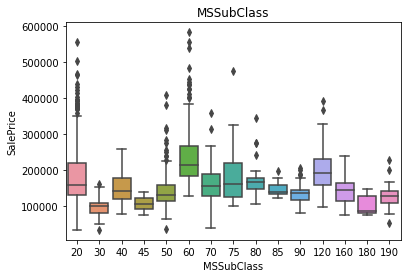

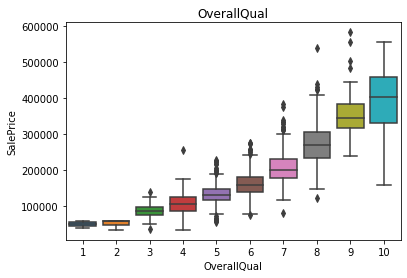

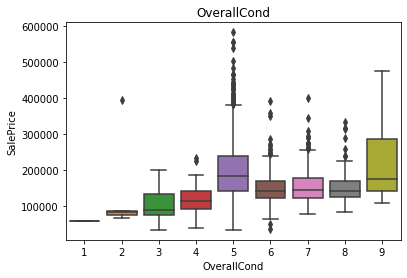

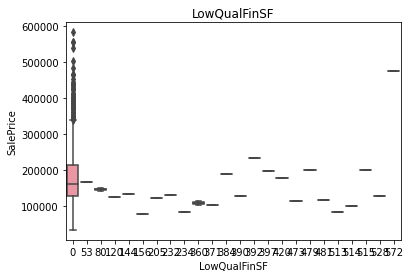

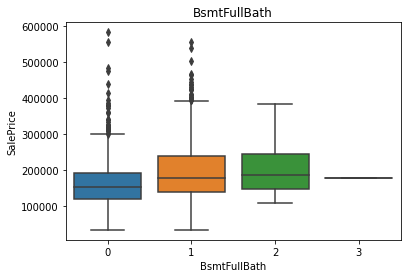

...

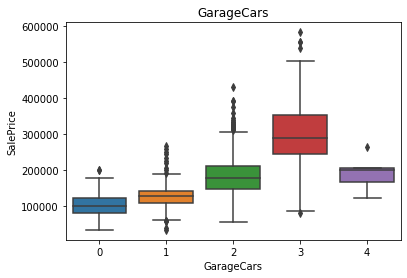

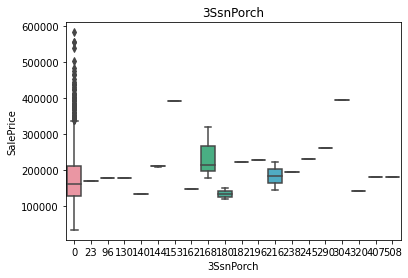

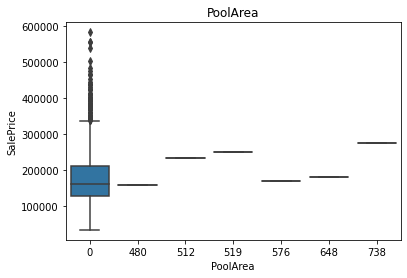

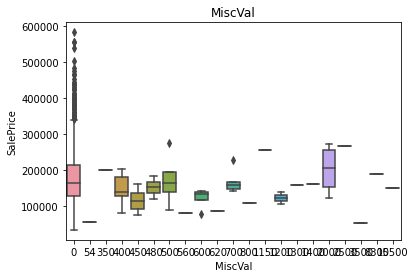

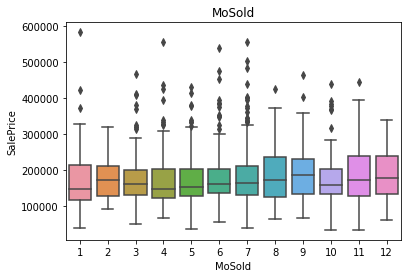

In [22]:
plot_all_boxplot(num_dis_cols,house_df)

**Feature Engineering Discrete : New Features created**

From above boxplot we can see LowQualFinSF and PoolArea has maximum data for value 0

In [23]:
# Creating new boolean features using business logic
house_df['Has_LowQualFinSF'] = house_df['LowQualFinSF'].apply(lambda x: x if x==0 else 1)
house_df['Has_Pool'] = house_df['PoolArea'].apply(lambda x: x if x==0 else 1)


In [24]:
# Deleting the columns used for feature engineering
dis_fe_cols=['PoolArea','LowQualFinSF']
for c in dis_fe_cols:
  del house_df[c]
  num_cols.remove(c)
  num_dis_cols.remove(c)

**Extracting Continuous Numerical Features**

In [25]:
num_con_cols=[]
for col in num_cols:
  # if col not in num_dis_cols and not in year_cols:
  if col not in num_dis_cols+year_cols:
    num_con_cols.append(col)

print('Number of Continuous features are',len(num_con_cols))
house_df[num_con_cols].head()


Number of Continuous features are 16


,LotFrontage,LotArea,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,GrLivArea,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,ScreenPorch,SalePrice
0,65.0,8450,196.0,706,0,150,856,856,854,1710,548,0,61,0,0,208500
1,80.0,9600,0.0,978,0,284,1262,1262,0,1262,460,298,0,0,0,181500
2,68.0,11250,162.0,486,0,434,920,920,866,1786,608,0,42,0,0,223500
3,60.0,9550,0.0,216,0,540,756,961,756,1717,642,0,35,272,0,140000
4,84.0,14260,350.0,655,0,490,1145,1145,1053,2198,836,192,84,0,0,250000


In [26]:
house_df[num_con_cols].isnull().sum()

LotFrontage      259
LotArea            0
MasVnrArea         8
BsmtFinSF1         0
BsmtFinSF2         0
BsmtUnfSF          0
TotalBsmtSF        0
1stFlrSF           0
2ndFlrSF           0
GrLivArea          0
GarageArea         0
WoodDeckSF         0
OpenPorchSF        0
EnclosedPorch      0
ScreenPorch        0
SalePrice          0
dtype: int64

In [27]:
con_cols_nan=['LotFrontage','MasVnrArea']
house_df[con_cols_nan].head(10)

,LotFrontage,MasVnrArea
0,65.0,196.0
1,80.0,0.0
2,68.0,162.0
3,60.0,0.0
4,84.0,350.0
5,85.0,0.0
6,75.0,186.0
7,NaN,240.0
8,51.0,0.0
9,50.0,0.0


*Imputing Missing values*

In [28]:
house_df['LotFrontage']=house_df['LotFrontage'].fillna(house_df['LotFrontage'].mean())

house_df[num_con_cols].isnull().sum()


LotFrontage      0
LotArea          0
MasVnrArea       8
BsmtFinSF1       0
BsmtFinSF2       0
BsmtUnfSF        0
TotalBsmtSF      0
1stFlrSF         0
2ndFlrSF         0
GrLivArea        0
GarageArea       0
WoodDeckSF       0
OpenPorchSF      0
EnclosedPorch    0
ScreenPorch      0
SalePrice        0
dtype: int64

In [29]:
house_df['MasVnrArea']=house_df['MasVnrArea'].fillna(house_df['MasVnrArea'].mean())

house_df[num_con_cols].isnull().sum()


LotFrontage      0
LotArea          0
MasVnrArea       0
BsmtFinSF1       0
BsmtFinSF2       0
BsmtUnfSF        0
TotalBsmtSF      0
1stFlrSF         0
2ndFlrSF         0
GrLivArea        0
GarageArea       0
WoodDeckSF       0
OpenPorchSF      0
EnclosedPorch    0
ScreenPorch      0
SalePrice        0
dtype: int64

**Feature Engineering : Continuous Numerical feature**

* Dropping Unnecessary columns
* Combining Columns to create new feature

In [30]:
house_df[['BsmtFinSF1','BsmtFinSF2','BsmtUnfSF','TotalBsmtSF']].head(10)

,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF
0,706,0,150,856
1,978,0,284,1262
2,486,0,434,920
3,216,0,540,756
4,655,0,490,1145
5,732,0,64,796
6,1369,0,317,1686
7,859,32,216,1107
8,0,0,952,952
9,851,0,140,991


As can be seen 

TotalBsmtSF = BsmtFinSF1 + BsmtFinSF2 +	BsmtUnfSF

So we will drop columns BsmtFinSF1,BsmtFinSF2,BsmtUnfSF

In [31]:
tc=['BsmtFinSF1','BsmtFinSF2','BsmtUnfSF']
for c in tc:
  del house_df[c]
  num_con_cols.remove(c)

house_df[num_con_cols].head()


,LotFrontage,LotArea,MasVnrArea,TotalBsmtSF,1stFlrSF,2ndFlrSF,GrLivArea,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,ScreenPorch,SalePrice
0,65.0,8450,196.0,856,856,854,1710,548,0,61,0,0,208500
1,80.0,9600,0.0,1262,1262,0,1262,460,298,0,0,0,181500
2,68.0,11250,162.0,920,920,866,1786,608,0,42,0,0,223500
3,60.0,9550,0.0,756,961,756,1717,642,0,35,272,0,140000
4,84.0,14260,350.0,1145,1145,1053,2198,836,192,84,0,0,250000


In [32]:
porch_cols=['OpenPorchSF','EnclosedPorch','ScreenPorch','3SsnPorch']
house_df[porch_cols].head(10)

,OpenPorchSF,EnclosedPorch,ScreenPorch,3SsnPorch
0,61,0,0,0
1,0,0,0,0
2,42,0,0,0
3,35,272,0,0
4,84,0,0,0
5,30,0,0,320
6,57,0,0,0
7,204,228,0,0
8,0,205,0,0
9,4,0,0,0


**Creating new feature TotalPorchArea**

In [33]:
house_df['TotalPorchArea']=house_df['OpenPorchSF']+house_df['EnclosedPorch']+house_df['ScreenPorch']+house_df['3SsnPorch']
house_df['TotalPorchArea'].head(10)

0     61
1      0
2     42
3    307
4     84
5    350
6     57
7    432
8    205
9      4
Name: TotalPorchArea, dtype: int64

*Update dataframes and list of columns*

In [34]:
for c in porch_cols:
  del house_df[c]

In [35]:
porch_cols.remove('3SsnPorch')

for c in porch_cols:
  num_con_cols.remove(c)

num_con_cols.append('TotalPorchArea')

In [36]:
num_con_cols.remove('SalePrice')

**EDA : Continuous Numerical Features**
* Building Regression Plots
* Removing Outliers by interpretting plots

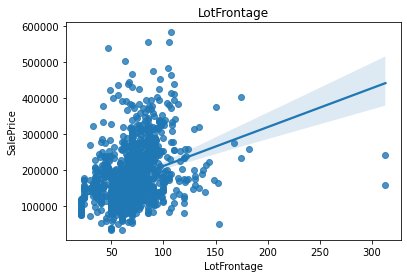

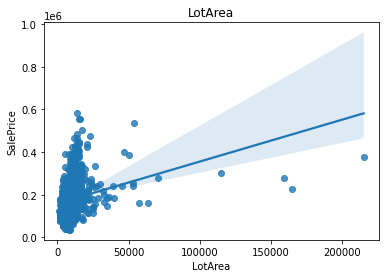

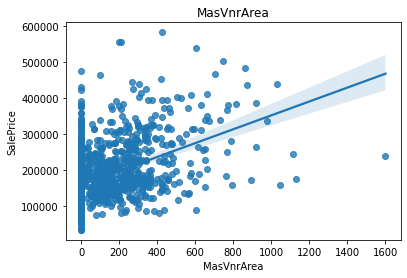

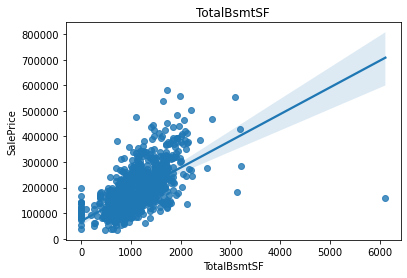

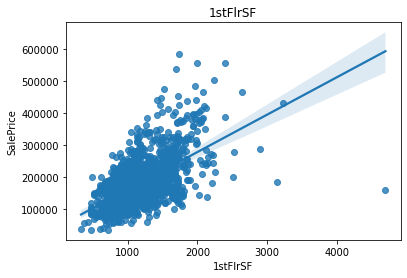

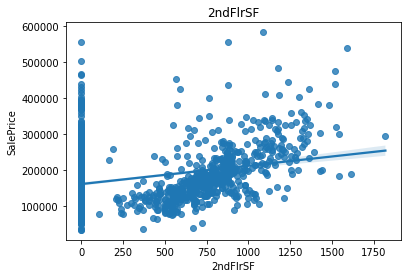

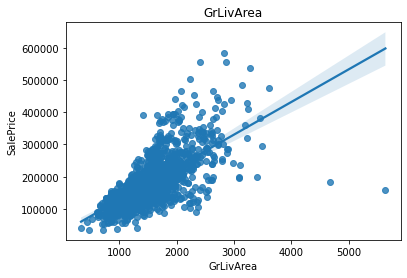

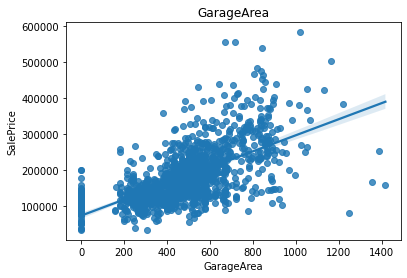

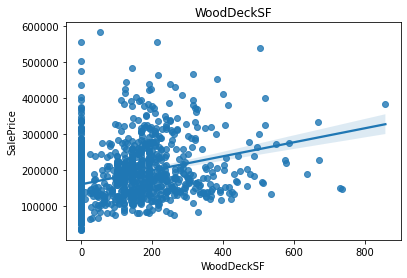

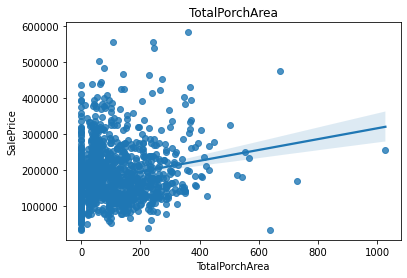

In [37]:
plot_all_regplot(num_con_cols,house_df)

*Based on Scatter Plots above*

* Outliers detection : we can remove the feature that has only one or two values above a certain limit

In [38]:
house_df=house_df[house_df['TotalPorchArea']<1000]


In [39]:
house_df=house_df[house_df['WoodDeckSF']<800]


In [40]:
house_df=house_df[house_df['GarageArea']<1400]


In [41]:
house_df=house_df[house_df['GrLivArea']<4000]


In [42]:
house_df=house_df[house_df['LotFrontage']<200]

In [43]:
house_df=house_df[house_df['LotArea']<100000]

In [44]:
house_df=house_df[house_df['TotalBsmtSF']<4000]

In [45]:
house_df=house_df[house_df['1stFlrSF']<4000]

In [46]:
house_df=house_df[house_df['MasVnrArea']<1400]

In [47]:
house_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1446 entries, 0 to 1459
Data columns (total 69 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   MSSubClass        1446 non-null   int64  
 1   MSZoning          1446 non-null   object 
 2   LotFrontage       1446 non-null   float64
 3   LotArea           1446 non-null   int64  
 4   Street            1446 non-null   object 
 5   LotShape          1446 non-null   object 
 6   LandContour       1446 non-null   object 
 7   Utilities         1446 non-null   object 
 8   LotConfig         1446 non-null   object 
 9   LandSlope         1446 non-null   object 
 10  Neighborhood      1446 non-null   object 
 11  Condition1        1446 non-null   object 
 12  Condition2        1446 non-null   object 
 13  BldgType          1446 non-null   object 
 14  HouseStyle        1446 non-null   object 
 15  OverallQual       1446 non-null   int64  
 16  OverallCond       1446 non-null   int64  


In [48]:
house_df.tail(10)

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinType2,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice,Has_LowQualFinSF,Has_Pool,TotalPorchArea
1450,90,RL,60.0,9000,Pave,Reg,Lvl,AllPub,FR2,Gtl,NAmes,Norm,Norm,Duplex,2Story,5,5,1974,1974,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,CBlock,Gd,TA,No,Unf,Unf,896,GasA,TA,Y,SBrkr,896,896,1792,0,0,2,2,4,2,TA,8,Typ,0,NaN,2005,NaN,0,0,NaN,NaN,Y,32,0,9,2009,WD,Normal,136000,0,0,45
1451,20,RL,78.0,9262,Pave,Reg,Lvl,AllPub,Inside,Gtl,Somerst,Norm,Norm,1Fam,1Story,8,5,2008,2009,Gable,CompShg,CemntBd,CmentBd,Stone,194.0,Gd,TA,PConc,Gd,TA,No,Unf,Unf,1573,GasA,Ex,Y,SBrkr,1578,0,1578,0,0,2,0,3,1,Ex,7,Typ,1,Attchd,2008,Fin,3,840,TA,TA,Y,0,0,5,2009,New,Partial,287090,0,0,36
1452,180,RM,35.0,3675,Pave,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,TwnhsE,SLvl,5,5,2005,2005,Gable,CompShg,VinylSd,VinylSd,BrkFace,80.0,TA,TA,PConc,Gd,TA,Gd,GLQ,Unf,547,GasA,Gd,Y,SBrkr,1072,0,1072,1,0,1,0,2,1,TA,5,Typ,0,Basment,2005,Fin,2,525,TA,TA,Y,0,0,5,2006,WD,Normal,145000,0,0,28
1453,20,RL,90.0,17217,Pave,Reg,Lvl,AllPub,Inside,Gtl,Mitchel,Norm,Norm,1Fam,1Story,5,5,2006,2006,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,PConc,Gd,TA,No,Unf,Unf,1140,GasA,Ex,Y,SBrkr,1140,0,1140,0,0,1,0,3,1,TA,6,Typ,0,NaN,2005,NaN,0,0,NaN,NaN,Y,36,0,7,2006,WD,Abnorml,84500,0,0,56
1454,20,FV,62.0,7500,Pave,Reg,Lvl,AllPub,Inside,Gtl,Somerst,Norm,Norm,1Fam,1Story,7,5,2004,2005,Gable,CompShg,VinylSd,VinylSd,None,0.0,Gd,TA,PConc,Gd,TA,No,GLQ,Unf,1221,GasA,Ex,Y,SBrkr,1221,0,1221,1,0,2,0,2,1,Gd,6,Typ,0,Attchd,2004,RFn,2,400,TA,TA,Y,0,0,10,2009,WD,Normal,185000,0,0,113
1455,60,RL,62.0,7917,Pave,Reg,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,5,1999,2000,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,PConc,Gd,TA,No,Unf,Unf,953,GasA,Ex,Y,SBrkr,953,694,1647,0,0,2,1,3,1,TA,7,Typ,1,Attchd,1999,RFn,2,460,TA,TA,Y,0,0,8,2007,WD,Normal,175000,0,0,40
1456,20,RL,85.0,13175,Pave,Reg,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,6,1978,1988,Gable,CompShg,Plywood,Plywood,Stone,119.0,TA,TA,CBlock,Gd,TA,No,ALQ,Rec,1542,GasA,TA,Y,SBrkr,2073,0,2073,1,0,2,0,3,1,TA,7,Min1,2,Attchd,1978,Unf,2,500,TA,TA,Y,349,0,2,2010,WD,Normal,210000,0,0,0
1457,70,RL,66.0,9042,Pave,Reg,Lvl,AllPub,Inside,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,9,1941,2006,Gable,CompShg,CemntBd,CmentBd,None,0.0,Ex,Gd,Stone,TA,Gd,No,GLQ,Unf,1152,GasA,Ex,Y,SBrkr,1188,1152,2340,0,0,2,0,4,1,Gd,9,Typ,2,Attchd,1941,RFn,1,252,TA,TA,Y,0,2500,5,2010,WD,Normal,266500,0,0,60
1458,20,RL,68.0,9717,Pave,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,5,6,1950,1996,Hip,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,TA,TA,Mn,GLQ,Rec,1078,GasA,Gd,Y,FuseA,1078,0,1078,1,0,1,0,2,1,Gd,5,Typ,0,Attchd,1950,Unf,1,240,TA,TA,Y,366,0,4,2010,WD,Normal,142125,0,0,112
1459,20,RL,75.0,9937,Pave,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,1Fam,1Story,5,6,1965,1965,Gable,CompShg,HdBoard,HdBoard,None,0.0,Gd,TA,CBlock,TA,TA,No,BLQ,LwQ,1256,GasA,Gd,Y,SBrkr,1256,0,1256,1,0,1,1,3,1,TA,6,Typ,0,Attchd,1965,Fin,1,276,TA,TA,Y,736,0,6,2008,WD,Normal,147500,0,0,68


**Extracting Categorical Variables**


In [49]:
cat_cols=[]
for col in house_df.columns:
  if house_df[col].dtypes=='O':
    cat_cols.append(col)

print(len(cat_cols))

house_df[cat_cols].head(10)

38


,MSZoning,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinType2,Heating,HeatingQC,CentralAir,Electrical,KitchenQual,Functional,GarageType,GarageFinish,GarageQual,GarageCond,PavedDrive,SaleType,SaleCondition
0,RL,Pave,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,Gable,CompShg,VinylSd,VinylSd,BrkFace,Gd,TA,PConc,Gd,TA,No,GLQ,Unf,GasA,Ex,Y,SBrkr,Gd,Typ,Attchd,RFn,TA,TA,Y,WD,Normal
1,RL,Pave,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,Gable,CompShg,MetalSd,MetalSd,None,TA,TA,CBlock,Gd,TA,Gd,ALQ,Unf,GasA,Ex,Y,SBrkr,TA,Typ,Attchd,RFn,TA,TA,Y,WD,Normal
2,RL,Pave,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,Gable,CompShg,VinylSd,VinylSd,BrkFace,Gd,TA,PConc,Gd,TA,Mn,GLQ,Unf,GasA,Ex,Y,SBrkr,Gd,Typ,Attchd,RFn,TA,TA,Y,WD,Normal
3,RL,Pave,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,Gable,CompShg,Wd Sdng,Wd Shng,None,TA,TA,BrkTil,TA,Gd,No,ALQ,Unf,GasA,Gd,Y,SBrkr,Gd,Typ,Detchd,Unf,TA,TA,Y,WD,Abnorml
4,RL,Pave,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,Gable,CompShg,VinylSd,VinylSd,BrkFace,Gd,TA,PConc,Gd,TA,Av,GLQ,Unf,GasA,Ex,Y,SBrkr,Gd,Typ,Attchd,RFn,TA,TA,Y,WD,Normal
5,RL,Pave,IR1,Lvl,AllPub,Inside,Gtl,Mitchel,Norm,Norm,1Fam,1.5Fin,Gable,CompShg,VinylSd,VinylSd,None,TA,TA,Wood,Gd,TA,No,GLQ,Unf,GasA,Ex,Y,SBrkr,TA,Typ,Attchd,Unf,TA,TA,Y,WD,Normal
6,RL,Pave,Reg,Lvl,AllPub,Inside,Gtl,Somerst,Norm,Norm,1Fam,1Story,Gable,CompShg,VinylSd,VinylSd,Stone,Gd,TA,PConc,Ex,TA,Av,GLQ,Unf,GasA,Ex,Y,SBrkr,Gd,Typ,Attchd,RFn,TA,TA,Y,WD,Normal
7,RL,Pave,IR1,Lvl,AllPub,Corner,Gtl,NWAmes,PosN,Norm,1Fam,2Story,Gable,CompShg,HdBoard,HdBoard,Stone,TA,TA,CBlock,Gd,TA,Mn,ALQ,BLQ,GasA,Ex,Y,SBrkr,TA,Typ,Attchd,RFn,TA,TA,Y,WD,Normal
8,RM,Pave,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Artery,Norm,1Fam,1.5Fin,Gable,CompShg,BrkFace,Wd Shng,None,TA,TA,BrkTil,TA,TA,No,Unf,Unf,GasA,Gd,Y,FuseF,TA,Min1,Detchd,Unf,Fa,TA,Y,WD,Abnorml
9,RL,Pave,Reg,Lvl,AllPub,Corner,Gtl,BrkSide,Artery,Artery,2fmCon,1.5Unf,Gable,CompShg,MetalSd,MetalSd,None,TA,TA,BrkTil,TA,TA,No,GLQ,Unf,GasA,Ex,Y,SBrkr,TA,Typ,Attchd,RFn,Gd,TA,Y,WD,Normal


In [50]:
house_df[cat_cols].isnull().sum()

MSZoning          0
Street            0
LotShape          0
LandContour       0
Utilities         0
LotConfig         0
LandSlope         0
Neighborhood      0
Condition1        0
Condition2        0
BldgType          0
HouseStyle        0
RoofStyle         0
RoofMatl          0
Exterior1st       0
Exterior2nd       0
MasVnrType        8
ExterQual         0
ExterCond         0
Foundation        0
BsmtQual         37
BsmtCond         37
BsmtExposure     38
BsmtFinType1     37
BsmtFinType2     38
Heating           0
HeatingQC         0
CentralAir        0
Electrical        1
KitchenQual       0
Functional        0
GarageType       81
GarageFinish     81
GarageQual       81
GarageCond       81
PavedDrive        0
SaleType          0
SaleCondition     0
dtype: int64

In [51]:
cat_nan_cols=[]

for col in cat_cols:
  if house_df[col].isnull().sum()!=0:
    cat_nan_cols.append(col)

house_df[cat_nan_cols].isnull().sum()

MasVnrType       8
BsmtQual        37
BsmtCond        37
BsmtExposure    38
BsmtFinType1    37
BsmtFinType2    38
Electrical       1
GarageType      81
GarageFinish    81
GarageQual      81
GarageCond      81
dtype: int64

*According to data definition given and business understanding Imputing Missing Values*

* Features regarding Basement, null value represents No Basement is present
* Features regarding Garage, null value represents No Garage is present
* Remaining Features impute missing values with mode

In [52]:
Bsmnt_cols=['BsmtQual','BsmtCond','BsmtExposure','BsmtFinType1','BsmtFinType2'] 

In [53]:
for c in Bsmnt_cols:
  house_df[c] = house_df[c].fillna('No Basement')


In [54]:
for c in Bsmnt_cols:
  print(house_df[c].value_counts())

TA             648
Gd             612
Ex             114
No Basement     37
Fa              35
Name: BsmtQual, dtype: int64
TA             1297
Gd               65
Fa               45
No Basement      37
Po                2
Name: BsmtCond, dtype: int64
No             951
Av             220
Gd             123
Mn             114
No Basement     38
Name: BsmtExposure, dtype: int64
Unf            430
GLQ            409
ALQ            218
BLQ            147
Rec            132
LwQ             73
No Basement     37
Name: BsmtFinType1, dtype: int64
Unf            1244
Rec              53
LwQ              46
No Basement      38
BLQ              32
ALQ              19
GLQ              14
Name: BsmtFinType2, dtype: int64


In [55]:
Garage_cols=['GarageType','GarageFinish','GarageQual','GarageCond']

In [56]:
for c in Garage_cols:
  house_df[c] = house_df[c].fillna('No Garage')


In [57]:
for c in Garage_cols:
  print(house_df[c].value_counts())

Attchd       859
Detchd       385
BuiltIn       87
No Garage     81
Basment       19
CarPort        9
2Types         6
Name: GarageType, dtype: int64
Unf          603
RFn          419
Fin          343
No Garage     81
Name: GarageFinish, dtype: int64
TA           1298
No Garage      81
Fa             47
Gd             14
Ex              3
Po              3
Name: GarageQual, dtype: int64
TA           1312
No Garage      81
Fa             35
Gd              9
Po              7
Ex              2
Name: GarageCond, dtype: int64


In [58]:
house_df.isnull().sum()

MSSubClass          0
MSZoning            0
LotFrontage         0
LotArea             0
Street              0
LotShape            0
LandContour         0
Utilities           0
LotConfig           0
LandSlope           0
Neighborhood        0
Condition1          0
Condition2          0
BldgType            0
HouseStyle          0
OverallQual         0
OverallCond         0
YearBuilt           0
YearRemodAdd        0
RoofStyle           0
RoofMatl            0
Exterior1st         0
Exterior2nd         0
MasVnrType          8
MasVnrArea          0
ExterQual           0
ExterCond           0
Foundation          0
BsmtQual            0
BsmtCond            0
BsmtExposure        0
BsmtFinType1        0
BsmtFinType2        0
TotalBsmtSF         0
Heating             0
HeatingQC           0
CentralAir          0
Electrical          1
1stFlrSF            0
2ndFlrSF            0
GrLivArea           0
BsmtFullBath        0
BsmtHalfBath        0
FullBath            0
HalfBath            0
BedroomAbv

In [59]:
house_df[cat_nan_cols]

,MasVnrType,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinType2,Electrical,GarageType,GarageFinish,GarageQual,GarageCond
0,BrkFace,Gd,TA,No,GLQ,Unf,SBrkr,Attchd,RFn,TA,TA
1,None,Gd,TA,Gd,ALQ,Unf,SBrkr,Attchd,RFn,TA,TA
2,BrkFace,Gd,TA,Mn,GLQ,Unf,SBrkr,Attchd,RFn,TA,TA
3,None,TA,Gd,No,ALQ,Unf,SBrkr,Detchd,Unf,TA,TA
4,BrkFace,Gd,TA,Av,GLQ,Unf,SBrkr,Attchd,RFn,TA,TA
5,None,Gd,TA,No,GLQ,Unf,SBrkr,Attchd,Unf,TA,TA
6,Stone,Ex,TA,Av,GLQ,Unf,SBrkr,Attchd,RFn,TA,TA
7,Stone,Gd,TA,Mn,ALQ,BLQ,SBrkr,Attchd,RFn,TA,TA
8,None,TA,TA,No,Unf,Unf,FuseF,Detchd,Unf,Fa,TA
9,None,TA,TA,No,GLQ,Unf,SBrkr,Attchd,RFn,Gd,TA


In [60]:
house_df['MasVnrType']=house_df['MasVnrType'].fillna(house_df['MasVnrArea'].mode()[0])
house_df['Electrical']=house_df['Electrical'].fillna(house_df['Electrical'].mode()[0])



In [61]:
house_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1446 entries, 0 to 1459
Data columns (total 69 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   MSSubClass        1446 non-null   int64  
 1   MSZoning          1446 non-null   object 
 2   LotFrontage       1446 non-null   float64
 3   LotArea           1446 non-null   int64  
 4   Street            1446 non-null   object 
 5   LotShape          1446 non-null   object 
 6   LandContour       1446 non-null   object 
 7   Utilities         1446 non-null   object 
 8   LotConfig         1446 non-null   object 
 9   LandSlope         1446 non-null   object 
 10  Neighborhood      1446 non-null   object 
 11  Condition1        1446 non-null   object 
 12  Condition2        1446 non-null   object 
 13  BldgType          1446 non-null   object 
 14  HouseStyle        1446 non-null   object 
 15  OverallQual       1446 non-null   int64  
 16  OverallCond       1446 non-null   int64  


**Feature Engineering: Deriving New features by Combining Multiple Temporal Features**


In [62]:
# Age of the house when sold
house_df['HouseAge'] = house_df['YrSold'] - house_df['YearBuilt']

# Years passed after remodeling of the house when sold
house_df['HouseRemodAge'] = house_df['YrSold'] - house_df['YearRemodAdd']

# Age of garage when house was sold
house_df['GarageAge'] = house_df['YrSold'] - house_df['GarageYrBlt']


In [63]:
# Deleting Features used to create new features that are no longer needed
for c in year_cols:
  del house_df[c]

In [64]:
house_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1446 entries, 0 to 1459
Data columns (total 68 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   MSSubClass        1446 non-null   int64  
 1   MSZoning          1446 non-null   object 
 2   LotFrontage       1446 non-null   float64
 3   LotArea           1446 non-null   int64  
 4   Street            1446 non-null   object 
 5   LotShape          1446 non-null   object 
 6   LandContour       1446 non-null   object 
 7   Utilities         1446 non-null   object 
 8   LotConfig         1446 non-null   object 
 9   LandSlope         1446 non-null   object 
 10  Neighborhood      1446 non-null   object 
 11  Condition1        1446 non-null   object 
 12  Condition2        1446 non-null   object 
 13  BldgType          1446 non-null   object 
 14  HouseStyle        1446 non-null   object 
 15  OverallQual       1446 non-null   int64  
 16  OverallCond       1446 non-null   int64  


In [65]:
house_df.head(15)

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinType2,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,GarageType,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,MiscVal,MoSold,SaleType,SaleCondition,SalePrice,Has_LowQualFinSF,Has_Pool,TotalPorchArea,HouseAge,HouseRemodAge,GarageAge
0,60,RL,65.00000,8450,Pave,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,Unf,856,GasA,Ex,Y,SBrkr,856,854,1710,1,0,2,1,3,1,Gd,8,Typ,0,Attchd,RFn,2,548,TA,TA,Y,0,0,2,WD,Normal,208500,0,0,61,5,5,5
1,20,RL,80.00000,9600,Pave,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,Unf,1262,GasA,Ex,Y,SBrkr,1262,0,1262,0,1,2,0,3,1,TA,6,Typ,1,Attchd,RFn,2,460,TA,TA,Y,298,0,5,WD,Normal,181500,0,0,0,31,31,31
2,60,RL,68.00000,11250,Pave,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,Unf,920,GasA,Ex,Y,SBrkr,920,866,1786,1,0,2,1,3,1,Gd,6,Typ,1,Attchd,RFn,2,608,TA,TA,Y,0,0,9,WD,Normal,223500,0,0,42,7,6,7
3,70,RL,60.00000,9550,Pave,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,Unf,756,GasA,Gd,Y,SBrkr,961,756,1717,1,0,1,0,3,1,Gd,7,Typ,1,Detchd,Unf,3,642,TA,TA,Y,0,0,2,WD,Abnorml,140000,0,0,307,91,36,8
4,60,RL,84.00000,14260,Pave,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,Unf,1145,GasA,Ex,Y,SBrkr,1145,1053,2198,1,0,2,1,4,1,Gd,9,Typ,1,Attchd,RFn,3,836,TA,TA,Y,192,0,12,WD,Normal,250000,0,0,84,8,8,8
5,50,RL,85.00000,14115,Pave,IR1,Lvl,AllPub,Inside,Gtl,Mitchel,Norm,Norm,1Fam,1.5Fin,5,5,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,Wood,Gd,TA,No,GLQ,Unf,796,GasA,Ex,Y,SBrkr,796,566,1362,1,0,1,1,1,1,TA,5,Typ,0,Attchd,Unf,2,480,TA,TA,Y,40,700,10,WD,Normal,143000,0,0,350,16,14,16
6,20,RL,75.00000,10084,Pave,Reg,Lvl,AllPub,Inside,Gtl,Somerst,Norm,Norm,1Fam,1Story,8,5,Gable,CompShg,VinylSd,VinylSd,Stone,186.0,Gd,TA,PConc,Ex,TA,Av,GLQ,Unf,1686,GasA,Ex,Y,SBrkr,1694,0,1694,1,0,2,0,3,1,Gd,7,Typ,1,Attchd,RFn,2,636,TA,TA,Y,255,0,8,WD,Normal,307000,0,0,57,3,2,3
7,60,RL,69.88137,10382,Pave,IR1,Lvl,AllPub,Corner,Gtl,NWAmes,PosN,Norm,1Fam,2Story,7,6,Gable,CompShg,HdBoard,HdBoard,Stone,240.0,TA,TA,CBlock,Gd,TA,Mn,ALQ,BLQ,1107,GasA,Ex,Y,SBrkr,1107,983,2090,1,0,2,1,3,1,TA,7,Typ,2,Attchd,RFn,2,484,TA,TA,Y,235,350,11,WD,Normal,200000,0,0,432,36,36,36
8,50,RM,51.00000,6120,Pave,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Artery,Norm,1Fam,1.5Fin,7,5,Gable,CompShg,BrkFace,Wd Shng,None,0.0,TA,TA,BrkTil,TA,TA,No,Unf,Unf,952,GasA,Gd,Y,FuseF,1022,752,1774,0,0,2,0,2,2,TA,8,Min1,2,Detchd,Unf,2,468,Fa,TA,Y,90,0,4,WD,Abnorml,129900,0,0,205,77,58,77
9,190,RL,50.00000,7420,Pave,Reg,Lvl,AllPub,Corner,Gtl,BrkSide,Artery,Artery,2fmCon,1.5Unf,5,6,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,BrkTil,TA,TA,No,GLQ,Unf,991,GasA,Ex,Y,SBrkr,1077,0,1077,1,0,1,0,2,2,TA,5,Typ,2,Attchd,RFn,1,205,Gd,TA,Y,0,0,1,WD,Normal,118000,0,0,4,69,58,69


**target variable assignment**

In [66]:
y=house_df.pop('SalePrice')
y

0       208500
1       181500
2       223500
3       140000
4       250000
5       143000
6       307000
7       200000
8       129900
9       118000
10      129500
11      345000
12      144000
13      279500
14      157000
15      132000
16      149000
17       90000
18      159000
19      139000
20      325300
21      139400
22      230000
23      129900
24      154000
25      256300
26      134800
27      306000
28      207500
29       68500
30       40000
31      149350
32      179900
33      165500
34      277500
35      309000
36      145000
37      153000
38      109000
39       82000
40      160000
41      170000
42      144000
43      130250
44      141000
45      319900
46      239686
47      249700
48      113000
49      127000
50      177000
51      114500
52      110000
54      130000
55      180500
56      172500
57      196500
58      438780
59      124900
60      158000
61      101000
62      202500
63      140000
64      219500
65      317000
66      180000
67      22

# Data Transformation : Log transformation
**Skewness Check**

* In case of positive skewness, log transformation works well.

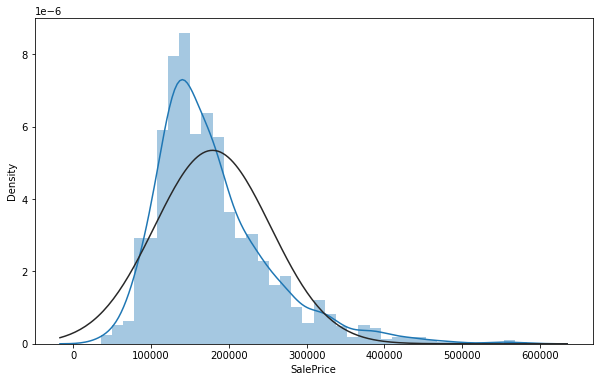

In [67]:
plt.figure(figsize=[10,6])
sns.distplot(y, fit=norm)

The target variable is right skewed. So we need to transform this variable and make it more normally distributed.

In [68]:
skew(y)

1.4435315310203798

In [69]:
y = np.log1p(y)


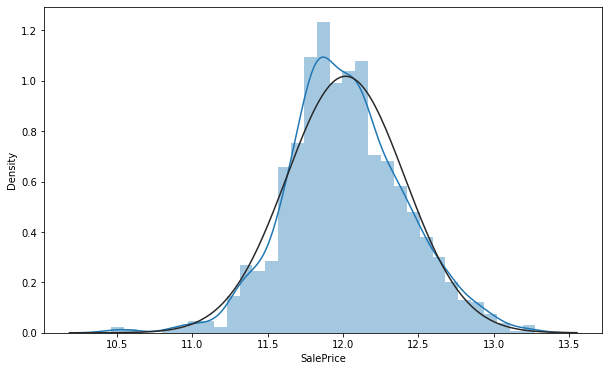

In [70]:
plt.figure(figsize=[10,6])
sns.distplot(y, fit=norm)

there is no more skewness in target variable

*Repeating the same process for other skewed features*

In [71]:
house_df.head(10)

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinType2,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,GarageType,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,MiscVal,MoSold,SaleType,SaleCondition,Has_LowQualFinSF,Has_Pool,TotalPorchArea,HouseAge,HouseRemodAge,GarageAge
0,60,RL,65.00000,8450,Pave,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,Unf,856,GasA,Ex,Y,SBrkr,856,854,1710,1,0,2,1,3,1,Gd,8,Typ,0,Attchd,RFn,2,548,TA,TA,Y,0,0,2,WD,Normal,0,0,61,5,5,5
1,20,RL,80.00000,9600,Pave,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,Unf,1262,GasA,Ex,Y,SBrkr,1262,0,1262,0,1,2,0,3,1,TA,6,Typ,1,Attchd,RFn,2,460,TA,TA,Y,298,0,5,WD,Normal,0,0,0,31,31,31
2,60,RL,68.00000,11250,Pave,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,Unf,920,GasA,Ex,Y,SBrkr,920,866,1786,1,0,2,1,3,1,Gd,6,Typ,1,Attchd,RFn,2,608,TA,TA,Y,0,0,9,WD,Normal,0,0,42,7,6,7
3,70,RL,60.00000,9550,Pave,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,Unf,756,GasA,Gd,Y,SBrkr,961,756,1717,1,0,1,0,3,1,Gd,7,Typ,1,Detchd,Unf,3,642,TA,TA,Y,0,0,2,WD,Abnorml,0,0,307,91,36,8
4,60,RL,84.00000,14260,Pave,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,Unf,1145,GasA,Ex,Y,SBrkr,1145,1053,2198,1,0,2,1,4,1,Gd,9,Typ,1,Attchd,RFn,3,836,TA,TA,Y,192,0,12,WD,Normal,0,0,84,8,8,8
5,50,RL,85.00000,14115,Pave,IR1,Lvl,AllPub,Inside,Gtl,Mitchel,Norm,Norm,1Fam,1.5Fin,5,5,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,Wood,Gd,TA,No,GLQ,Unf,796,GasA,Ex,Y,SBrkr,796,566,1362,1,0,1,1,1,1,TA,5,Typ,0,Attchd,Unf,2,480,TA,TA,Y,40,700,10,WD,Normal,0,0,350,16,14,16
6,20,RL,75.00000,10084,Pave,Reg,Lvl,AllPub,Inside,Gtl,Somerst,Norm,Norm,1Fam,1Story,8,5,Gable,CompShg,VinylSd,VinylSd,Stone,186.0,Gd,TA,PConc,Ex,TA,Av,GLQ,Unf,1686,GasA,Ex,Y,SBrkr,1694,0,1694,1,0,2,0,3,1,Gd,7,Typ,1,Attchd,RFn,2,636,TA,TA,Y,255,0,8,WD,Normal,0,0,57,3,2,3
7,60,RL,69.88137,10382,Pave,IR1,Lvl,AllPub,Corner,Gtl,NWAmes,PosN,Norm,1Fam,2Story,7,6,Gable,CompShg,HdBoard,HdBoard,Stone,240.0,TA,TA,CBlock,Gd,TA,Mn,ALQ,BLQ,1107,GasA,Ex,Y,SBrkr,1107,983,2090,1,0,2,1,3,1,TA,7,Typ,2,Attchd,RFn,2,484,TA,TA,Y,235,350,11,WD,Normal,0,0,432,36,36,36
8,50,RM,51.00000,6120,Pave,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Artery,Norm,1Fam,1.5Fin,7,5,Gable,CompShg,BrkFace,Wd Shng,None,0.0,TA,TA,BrkTil,TA,TA,No,Unf,Unf,952,GasA,Gd,Y,FuseF,1022,752,1774,0,0,2,0,2,2,TA,8,Min1,2,Detchd,Unf,2,468,Fa,TA,Y,90,0,4,WD,Abnorml,0,0,205,77,58,77
9,190,RL,50.00000,7420,Pave,Reg,Lvl,AllPub,Corner,Gtl,BrkSide,Artery,Artery,2fmCon,1.5Unf,5,6,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,BrkTil,TA,TA,No,GLQ,Unf,991,GasA,Ex,Y,SBrkr,1077,0,1077,1,0,1,0,2,2,TA,5,Typ,2,Attchd,RFn,1,205,Gd,TA,Y,0,0,1,WD,Normal,0,0,4,69,58,69


In [72]:
skewness = house_df.select_dtypes(exclude='object').skew()
skewed_cols = skewness[skewness>0.5]
skewed_cols

MSSubClass           1.399438
LotFrontage          0.697694
LotArea              3.955804
OverallCond          0.691522
MasVnrArea           2.305297
1stFlrSF             0.870736
2ndFlrSF             0.766369
GrLivArea            0.817874
BsmtFullBath         0.571228
BsmtHalfBath         4.145033
HalfBath             0.686038
KitchenAbvGr         4.463742
TotRmsAbvGrd         0.662560
Fireplaces           0.638722
WoodDeckSF           1.436152
MiscVal             24.550143
Has_LowQualFinSF     7.262444
Has_Pool            16.935122
TotalPorchArea       1.663888
HouseAge             0.605376
GarageAge            0.709788
dtype: float64

In [73]:
# # skewed_cols = X[num_con_cols].apply(lambda x: skew(x)) #compute skewness
# skewed_cols = house_df.apply(lambda x: skew(x)) #compute skewness

# skewed_cols = skewed_cols[skewed_cols > 0.75]
# skewed_cols

In [74]:
len(skewed_cols)

21

In [75]:
skewed_cols.index

Index(['MSSubClass', 'LotFrontage', 'LotArea', 'OverallCond', 'MasVnrArea',
       '1stFlrSF', '2ndFlrSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath',
       'HalfBath', 'KitchenAbvGr', 'TotRmsAbvGrd', 'Fireplaces', 'WoodDeckSF',
       'MiscVal', 'Has_LowQualFinSF', 'Has_Pool', 'TotalPorchArea', 'HouseAge',
       'GarageAge'],
      dtype='object')

In [76]:
skewed_cols=list(skewed_cols.index)
skewed_cols

['MSSubClass',
 'LotFrontage',
 'LotArea',
 'OverallCond',
 'MasVnrArea',
 '1stFlrSF',
 '2ndFlrSF',
 'GrLivArea',
 'BsmtFullBath',
 'BsmtHalfBath',
 'HalfBath',
 'KitchenAbvGr',
 'TotRmsAbvGrd',
 'Fireplaces',
 'WoodDeckSF',
 'MiscVal',
 'Has_LowQualFinSF',
 'Has_Pool',
 'TotalPorchArea',
 'HouseAge',
 'GarageAge']

In [77]:
house_df[skewed_cols] = np.log1p(house_df[skewed_cols])
house_df.head(15)

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinType2,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,GarageType,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,MiscVal,MoSold,SaleType,SaleCondition,Has_LowQualFinSF,Has_Pool,TotalPorchArea,HouseAge,HouseRemodAge,GarageAge
0,4.110874,RL,4.189655,9.042040,Pave,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,1.791759,Gable,CompShg,VinylSd,VinylSd,BrkFace,5.283204,Gd,TA,PConc,Gd,TA,No,GLQ,Unf,856,GasA,Ex,Y,SBrkr,6.753438,6.751101,7.444833,0.693147,0.000000,2,0.693147,3,0.693147,Gd,2.197225,Typ,0.000000,Attchd,RFn,2,548,TA,TA,Y,0.000000,0.000000,2,WD,Normal,0.0,0.0,4.127134,1.791759,5,1.791759
1,3.044522,RL,4.394449,9.169623,Pave,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,2.197225,Gable,CompShg,MetalSd,MetalSd,None,0.000000,TA,TA,CBlock,Gd,TA,Gd,ALQ,Unf,1262,GasA,Ex,Y,SBrkr,7.141245,0.000000,7.141245,0.000000,0.693147,2,0.000000,3,0.693147,TA,1.945910,Typ,0.693147,Attchd,RFn,2,460,TA,TA,Y,5.700444,0.000000,5,WD,Normal,0.0,0.0,0.000000,3.465736,31,3.465736
2,4.110874,RL,4.234107,9.328212,Pave,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,1.791759,Gable,CompShg,VinylSd,VinylSd,BrkFace,5.093750,Gd,TA,PConc,Gd,TA,Mn,GLQ,Unf,920,GasA,Ex,Y,SBrkr,6.825460,6.765039,7.488294,0.693147,0.000000,2,0.693147,3,0.693147,Gd,1.945910,Typ,0.693147,Attchd,RFn,2,608,TA,TA,Y,0.000000,0.000000,9,WD,Normal,0.0,0.0,3.761200,2.079442,6,2.079442
3,4.262680,RL,4.110874,9.164401,Pave,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,1.791759,Gable,CompShg,Wd Sdng,Wd Shng,None,0.000000,TA,TA,BrkTil,TA,Gd,No,ALQ,Unf,756,GasA,Gd,Y,SBrkr,6.869014,6.629363,7.448916,0.693147,0.000000,1,0.000000,3,0.693147,Gd,2.079442,Typ,0.693147,Detchd,Unf,3,642,TA,TA,Y,0.000000,0.000000,2,WD,Abnorml,0.0,0.0,5.730100,4.521789,36,2.197225
4,4.110874,RL,4.442651,9.565284,Pave,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,1.791759,Gable,CompShg,VinylSd,VinylSd,BrkFace,5.860786,Gd,TA,PConc,Gd,TA,Av,GLQ,Unf,1145,GasA,Ex,Y,SBrkr,7.044033,6.960348,7.695758,0.693147,0.000000,2,0.693147,4,0.693147,Gd,2.302585,Typ,0.693147,Attchd,RFn,3,836,TA,TA,Y,5.262690,0.000000,12,WD,Normal,0.0,0.0,4.442651,2.197225,8,2.197225
5,3.931826,RL,4.454347,9.555064,Pave,IR1,Lvl,AllPub,Inside,Gtl,Mitchel,Norm,Norm,1Fam,1.5Fin,5,1.791759,Gable,CompShg,VinylSd,VinylSd,None,0.000000,TA,TA,Wood,Gd,TA,No,GLQ,Unf,796,GasA,Ex,Y,SBrkr,6.680855,6.340359,7.217443,0.693147,0.000000,1,0.693147,1,0.693147,TA,1.791759,Typ,0.000000,Attchd,Unf,2,480,TA,TA,Y,3.713572,6.552508,10,WD,Normal,0.0,0.0,5.860786,2.833213,14,2.833213
6,3.044522,RL,4.330733,9.218804,Pave,Reg,Lvl,AllPub,Inside,Gtl,Somerst,Norm,Norm,1Fam,1Story,8,1.791759,Gable,CompShg,VinylSd,VinylSd,Stone,5.231109,Gd,TA,PConc,Ex,TA,Av,GLQ,Unf,1686,GasA,Ex,Y,SBrkr,7.435438,0.000000,7.435438,0.693147,0.000000,2,0.000000,3,0.693147,Gd,2.079442,Typ,0.693147,Attchd,RFn,2,636,TA,TA,Y,5.545177,0.000000,8,WD,Normal,0.0,0.0,4.060443,1.386294,2,1.386294
7,4.110874,RL,4.261008,9.247925,Pave,IR1,Lvl,AllPub,Corner,Gtl,NWAmes,PosN,Norm,1Fam,2Story,7,1.945910,Gable,CompShg,HdBoard,HdBoard,Stone,5.484797,TA,TA,CBlock,Gd,TA,Mn,ALQ,BLQ,1107,GasA,Ex,Y,SBrkr,7.010312,6.891626,7.645398,0.693147,0.000000,2,0.693147,3,0.693147,TA,2.079442,Typ,1.098612,Attchd,RFn,2,484,TA,TA,Y,5.463832,5.860786,11,WD,Normal,0.0,0.0,6.070738,3.610918,36,3.610918
8,3.931826,RM,3.951244,8.719481,Pave,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Artery,Norm,1Fam,1.5Fin,7,1.791759,Gable,CompShg,BrkFace,Wd Shng,None,0.000000,TA,TA,BrkTil,TA,TA,No,Unf,Unf,952,GasA,Gd,Y,FuseF,6.9

# Creating Dummy Variables

In [78]:
X=pd.get_dummies(data=house_df, columns=cat_cols,drop_first=True)
X

,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,MasVnrArea,TotalBsmtSF,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageCars,GarageArea,WoodDeckSF,MiscVal,MoSold,Has_LowQualFinSF,Has_Pool,TotalPorchArea,HouseAge,HouseRemodAge,GarageAge,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,Street_Pave,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,Utilities_NoSeWa,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,LandSlope_Mod,LandSlope_Sev,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,Condition1_RRAe,Condition1_RRAn,Condition1_RRNe,Condition1_RRNn,Condition2_Feedr,Condition2_Norm,Condition2_PosA,Condition2_PosN,Condition2_RRAe,Condition2_RRAn,Condition2_RRNn,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofStyle_Shed,RoofMatl_Membran,RoofMatl_Metal,RoofMatl_Roll,RoofMatl_Tar&Grv,RoofMatl_WdShake,RoofMatl_WdShngl,Exterior1st_AsphShn,Exterior1st_BrkComm,Exterior1st_BrkFace,Exterior1st_CBlock,Exterior1st_CemntBd,Exterior1st_HdBoard,Exterior1st_ImStucc,Exterior1st_MetalSd,Exterior1st_Plywood,Exterior1st_Stone,Exterior1st_Stucco,Exterior1st_VinylSd,Exterior1st_Wd Sdng,Exterior1st_WdShing,Exterior2nd_AsphShn,Exterior2nd_Brk Cmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_BrkCmn,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,ExterCond_Fa,ExterCond_Gd,ExterCond_Po,ExterCond_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_No Basement,BsmtQual_TA,BsmtCond_Gd,BsmtCond_No Basement,BsmtCond_Po,BsmtCond_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtExposure_No Basement,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_No Basement,BsmtFinType1_Rec,BsmtFinType1_Unf,BsmtFinType2_BLQ,BsmtFinType2_GLQ,BsmtFinType2_LwQ,BsmtFinType2_No Basement,BsmtFinType2_Rec,BsmtFinType2_Unf,Heating_GasA,Heating_GasW,Heating_Grav,Heating_OthW,Heating_Wall,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,CentralAir_Y,Electrical_FuseF,Electrical_FuseP,Electrical_Mix,Electrical_SBrkr,KitchenQual_Fa,KitchenQual_Gd,KitchenQual_TA,Functional_Maj2,Functional_Min1,Functional_Min2,Functional_Mod,Functional_Sev,Functional_Typ,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageType_No Garage,GarageFinish_No Garage,GarageFinish_RFn,GarageFinish_Unf,GarageQual_Fa,GarageQual_Gd,GarageQual_No Garage,GarageQual_Po,GarageQual_TA,GarageCond_Fa,GarageCond_Gd,GarageCond_No Garage,GarageCond_Po,GarageCond_TA,PavedDrive_P,PavedDrive_Y,SaleType_CWD,SaleType_Con,SaleType_ConLD,SaleType_ConLI,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal,SaleCondition_Partial
0,4.110874,4.189655,9.042040,7,1.791759,5.283204,856,6.753438,6.751101,7.444833,0.693147,0.000000,2,0.693147,3,0.693147,2.197225,0.000000,2,548,0.000000,0.000000,2,0.000000,0.000000,4.127134,1.7917

In [79]:
X.shape

(1446, 234)

In [80]:
# Creating Custom Residual Analysis and distribution error functions

def res_analysis(y_act,y_pred):
  y_res = y_test - y_pred_test

  # Scatter plot of the predicted values on the x-axis and the residuals on the y-axis
  plt.scatter( y_pred_test , y_res)
  plt.axhline(y=0, color='r', linestyle=':')
  plt.xlabel("Predicted Sale Price")
  plt.ylabel("Residual")
  plt.show()

def dis_analysis(y_act,y_pred):
  y_res=y_act-y_pred
  sns.distplot(y_res,kde=True)
  plt.title('Normality of error terms/residuals')
  plt.xlabel("Residuals")
  plt.show()

In [81]:
# Creating custom functions to measure key performance metrics.

# List to store model names and their key performance metrics
model_name=[]
model_rss = []
model_rmse = []

def model_evaluation(m_name,y_test,y_pred_test):
    
    model_name.append(m_name)
    print('Model Name:', m_name)

    # Residual Sum of Squares or Cost function
    rss_test = np.sum(np.square(y_test - y_pred_test))
    print('RSS :', rss_test)
    model_rss.append(rss_test)
    
    # RMSE
    rmse_test = np.sqrt(mean_squared_error(y_test, y_pred_test))
    model_rmse.append(rmse_test)
    print('RMSE:', rmse_test)

In [82]:
# split into train and test
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, 
                                                    train_size=0.7,
                                                    test_size = 0.3, random_state=100)

# Model 1 : RFE and MLR

* **Feature Selection using RFE**
* **Multiple Linear Regression**

In [83]:
# Instantiate
house_mlr = LinearRegression()

# Fit a line
house_mlr.fit(X_train, y_train)

LinearRegression()

In [84]:
rfe = RFE(house_mlr,n_features_to_select=35)

rfe = rfe.fit(X_train, y_train)
list(zip(X_train.columns,rfe.support_,rfe.ranking_))

[('MSSubClass', False, 183),
 ('LotFrontage', False, 112),
 ('LotArea', False, 30),
 ('OverallQual', False, 58),
 ('OverallCond', False, 9),
 ('MasVnrArea', False, 156),
 ('TotalBsmtSF', False, 194),
 ('1stFlrSF', True, 1),
 ('2ndFlrSF', False, 176),
 ('GrLivArea', True, 1),
 ('BsmtFullBath', False, 22),
 ('BsmtHalfBath', False, 149),
 ('FullBath', False, 91),
 ('HalfBath', False, 142),
 ('BedroomAbvGr', False, 145),
 ('KitchenAbvGr', True, 1),
 ('TotRmsAbvGrd', False, 153),
 ('Fireplaces', False, 93),
 ('GarageCars', False, 48),
 ('GarageArea', False, 193),
 ('WoodDeckSF', False, 178),
 ('MiscVal', False, 182),
 ('MoSold', False, 189),
 ('Has_LowQualFinSF', False, 158),
 ('Has_Pool', False, 32),
 ('TotalPorchArea', False, 179),
 ('HouseAge', False, 35),
 ('HouseRemodAge', False, 187),
 ('GarageAge', False, 175),
 ('MSZoning_FV', True, 1),
 ('MSZoning_RH', True, 1),
 ('MSZoning_RL', True, 1),
 ('MSZoning_RM', True, 1),
 ('Street_Pave', False, 34),
 ('LotShape_IR2', False, 114),
 ('LotS

In [85]:
sup_cols = X_train.columns[rfe.support_]
sup_cols

Index(['1stFlrSF', 'GrLivArea', 'KitchenAbvGr', 'MSZoning_FV', 'MSZoning_RH',
       'MSZoning_RL', 'MSZoning_RM', 'LandSlope_Sev', 'Condition2_PosA',
       'HouseStyle_2.5Fin', 'RoofMatl_Metal', 'Exterior2nd_CBlock',
       'ExterCond_Fa', 'ExterCond_Po', 'Foundation_Stone', 'BsmtQual_Fa',
       'BsmtQual_Gd', 'BsmtQual_No Basement', 'BsmtQual_TA',
       'BsmtCond_No Basement', 'BsmtCond_Po', 'BsmtFinType1_No Basement',
       'Electrical_Mix', 'Functional_Maj2', 'Functional_Sev',
       'GarageType_No Garage', 'GarageQual_Fa', 'GarageQual_Gd',
       'GarageQual_No Garage', 'GarageQual_TA', 'GarageCond_Fa',
       'GarageCond_Gd', 'GarageCond_Po', 'GarageCond_TA', 'SaleType_ConLD'],
      dtype='object')

In [86]:
X_rfe=X_train[sup_cols]
X_test_rfe=X_test[sup_cols]
X_rfe.head(10)

,1stFlrSF,GrLivArea,KitchenAbvGr,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LandSlope_Sev,Condition2_PosA,HouseStyle_2.5Fin,RoofMatl_Metal,Exterior2nd_CBlock,ExterCond_Fa,ExterCond_Po,Foundation_Stone,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_No Basement,BsmtQual_TA,BsmtCond_No Basement,BsmtCond_Po,BsmtFinType1_No Basement,Electrical_Mix,Functional_Maj2,Functional_Sev,GarageType_No Garage,GarageQual_Fa,GarageQual_Gd,GarageQual_No Garage,GarageQual_TA,GarageCond_Fa,GarageCond_Gd,GarageCond_Po,GarageCond_TA,SaleType_ConLD
410,7.152269,7.152269,0.693147,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0
45,7.469084,7.469084,0.693147,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0
1162,6.796824,6.796824,0.693147,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0
1372,7.011214,7.648740,0.693147,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0
525,7.144407,7.144407,0.693147,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0
161,7.360740,7.889459,0.693147,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0
1070,6.955593,6.955593,0.693147,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0
799,6.889591,7.478170,0.693147,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0
107,6.672033,6.672033,0.693147,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0
1307,6.898715,6.898715,0.693147,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0


In [87]:
X_test_rfe.shape

(434, 35)

In [88]:
# Instantiate
house_mlr = LinearRegression()

# Fit a line
house_mlr.fit(X_rfe, y_train)

LinearRegression()

In [89]:
y_pred_test = house_mlr.predict(X_test_rfe)

model_evaluation('RFE and MLR',y_test,y_pred_test)

Model Name: RFE and MLR
RSS : 16.88077736019425
RMSE: 0.19722018245887304


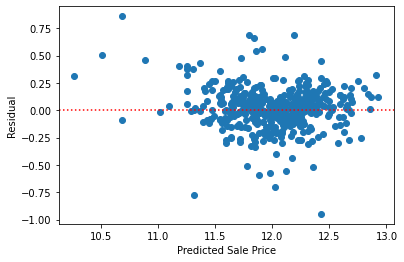

In [90]:
# Residual Analysis
res_analysis(y_test,y_pred_test)

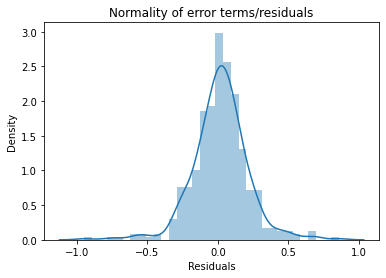

In [91]:
# Distribution of errors
dis_analysis(y_test,y_pred_test)

# REGULARIZATION

In [92]:
# list of alphas to tune - if value too high it will lead to underfitting, if it is too low, 
# it will not handle the overfitting
lambdas = {'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1, 
 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0, 
 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20, 50, 100, 500, 1000 ]}

# cross validation
folds = 5

# Model 2 : RFE and Ridge

* **Feature Selection using RFE**
* **RIDGE Regularization**
* **Cross validation to achieve optimal alpha** 

*Finding Best alpha*

In [93]:
ridge = Ridge()

ridge_model = GridSearchCV(estimator = ridge, 
                        param_grid = lambdas, 
                        scoring= 'neg_mean_squared_error',  
                        cv = folds, 
                        return_train_score=True,
                        verbose = 1)            
ridge_model.fit(X_rfe, y_train) 


Fitting 5 folds for each of 28 candidates, totalling 140 fits


GridSearchCV(cv=5, estimator=Ridge(),
             param_grid={'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1, 0.2, 0.3,
                                   0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0,
                                   4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20, 50,
                                   100, 500, 1000]},
             return_train_score=True, scoring='neg_mean_squared_error',
             verbose=1)

In [94]:
# Printing the best hyperparameter alpha
ridge_best_alpha=ridge_model.best_params_['alpha']
print(ridge_best_alpha)

0.01


In [95]:
#Creating Ridge model for best alpha
ridge_1 = Ridge(alpha=ridge_best_alpha)

# Fitting the models on training data
ridge_1.fit(X_rfe, y_train)

Ridge(alpha=0.01)

In [96]:
# Predicting values using test data
y_pred_test = ridge_1.predict(X_test_rfe)

# Performing error metrics 
model_evaluation('RFE and Ridge',y_test,y_pred_test)

Model Name: RFE and Ridge
RSS : 16.615292152484194
RMSE: 0.19566318841482377


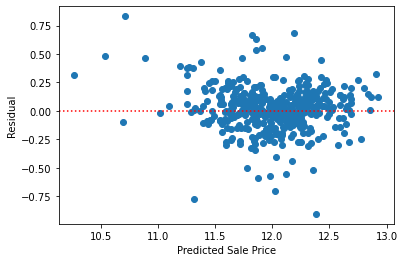

In [97]:
# Residual Analysis
res_analysis(y_test,y_pred_test)

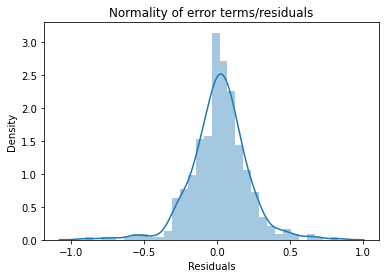

In [98]:
dis_analysis(y_test,y_pred_test)

In [99]:
rc_1 = pd.Series(ridge_1.coef_, index = X_rfe.columns)

In [100]:
imp_coef_r1 = pd.concat([rc_1.sort_values().head(10),rc_1.sort_values().tail(10)])

*Graph denoting important coefficients*

Text(0.5, 1.0, 'Coefficients in the Ridge Model')

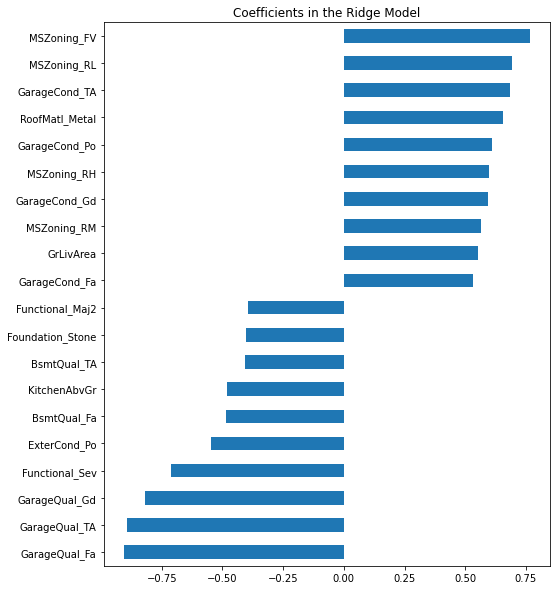

In [101]:
plt.rcParams['figure.figsize'] = (8.0, 10.0)
imp_coef_r1.plot(kind = "barh")
plt.title("Coefficients in the Ridge Model")

# Model 3 : Ridge twice alpha

* **Creating Ridge Model with twice the best alpha achieved for ridge**

In [102]:
# Creating Ridge model for twice the alpha
twice_alpha=ridge_best_alpha*2
ridge_2=Ridge(alpha=twice_alpha)

ridge_2.fit(X_rfe, y_train)

Ridge(alpha=0.02)

In [103]:
y_pred_test_ques=ridge_2.predict(X_test_rfe)

model_evaluation('Ridge twice alpha',y_test,y_pred_test_ques)


Model Name: Ridge twice alpha
RSS : 16.3875956775763
RMSE: 0.1943178762880726


In [104]:
rc_2 = pd.Series(ridge_2.coef_, index = X_rfe.columns)

imp_coef_r2 = pd.concat([rc_2.sort_values().head(10),rc_2.sort_values().tail(10)])

*Getting Important Predictor Variables*

Text(0.5, 1.0, 'Coefficients in the Ridge Model')

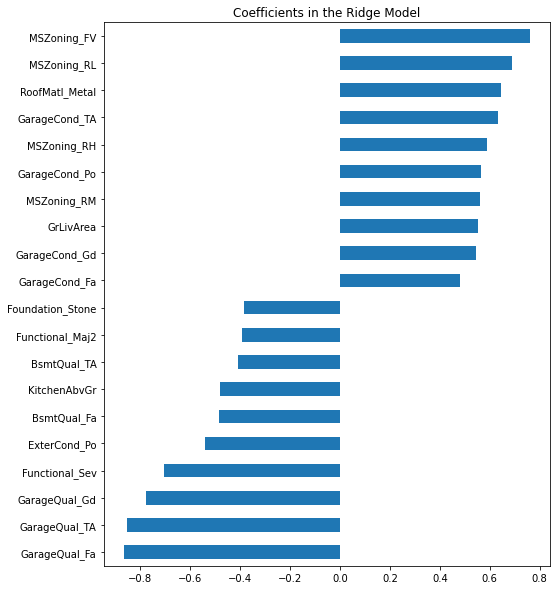

In [105]:
plt.rcParams['figure.figsize'] = (8.0, 10.0)
imp_coef_r2.plot(kind = "barh")
plt.title("Coefficients in the Ridge Model")

# Model 4 : Lasso Regularization

* **Feature selection and model building using Lasso Regularization**
* **Cross Validation to find optimal alpha** 

In [106]:
lasso = Lasso()

# cross validation
lasso_model = GridSearchCV(estimator = lasso, 
                        param_grid = lambdas, 
                        scoring= 'neg_mean_squared_error', 
                        cv = folds, 
                        return_train_score=True,
                        verbose = 1)            

lasso_model.fit(X_train, y_train) 

Fitting 5 folds for each of 28 candidates, totalling 140 fits


GridSearchCV(cv=5, estimator=Lasso(),
             param_grid={'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1, 0.2, 0.3,
                                   0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0,
                                   4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20, 50,
                                   100, 500, 1000]},
             return_train_score=True, scoring='neg_mean_squared_error',
             verbose=1)

In [107]:
# Printing the best hyperparameter alpha
lasso_best_alpha=lasso_model.best_params_['alpha']
print(lasso_best_alpha)

0.001


In [108]:
#Fitting Lasso model for best alpha
lasso_1 = Lasso(alpha=lasso_best_alpha)

lasso_1.fit(X_train, y_train) 

Lasso(alpha=0.001)

In [109]:
# Predicting Values using lasso model
y_pred_test = lasso_1.predict(X_test)

# Testing Model accuracy
model_evaluation('Lasso Regularization',y_test,y_pred_test)

Model Name: Lasso Regularization
RSS : 6.214214908367262
RMSE: 0.11965979914240264


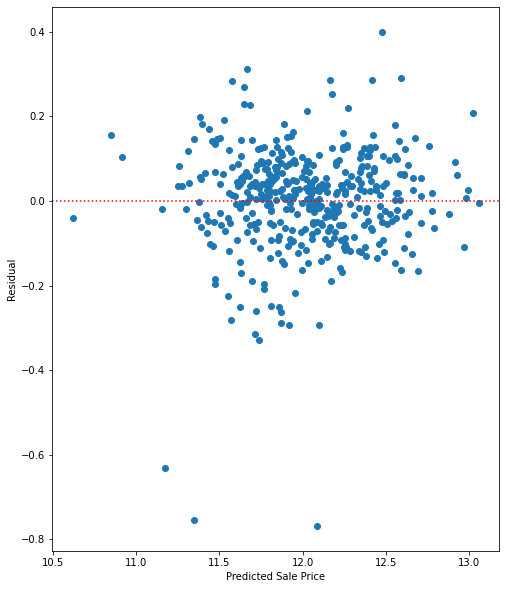

In [110]:
res_analysis(y_test,y_pred_test)

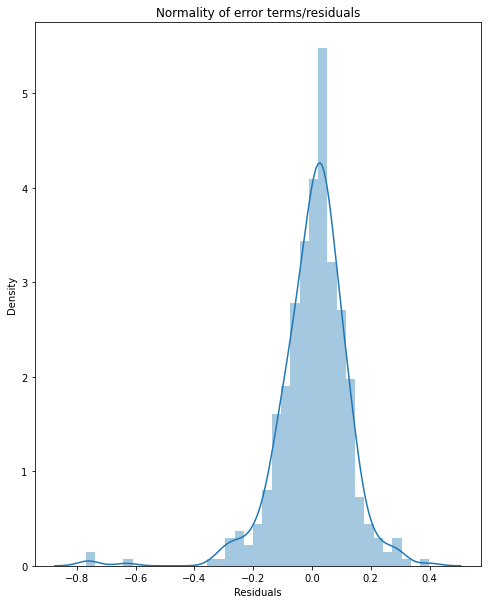

In [111]:
dis_analysis(y_test,y_pred_test)

*Getting the most important Predictor Variables*

In [112]:
lc_1 = pd.Series(lasso_1.coef_, index = X_train.columns)

In [113]:
imp_coef_l1 = pd.concat([lc_1.sort_values().head(10),lc_1.sort_values().tail(10)])

Text(0.5, 1.0, 'Coefficients in the Lasso Model')

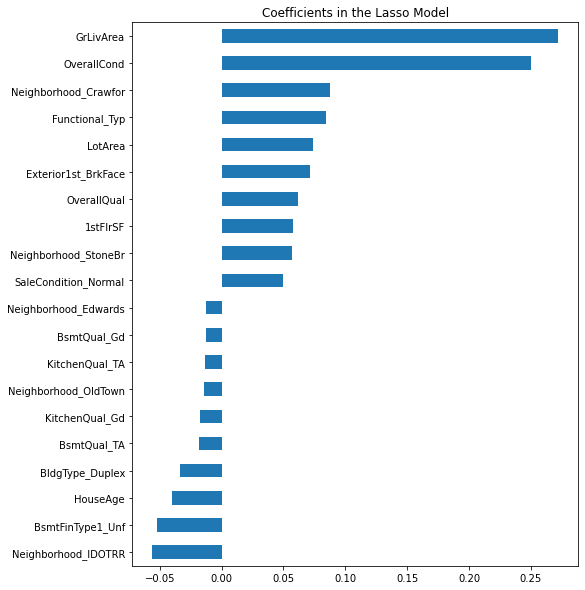

In [114]:
plt.rcParams['figure.figsize'] = (8.0, 10.0)
imp_coef_l1.plot(kind = "barh")
plt.title("Coefficients in the Lasso Model")

# Model 5 : Lasso twice alpha

* **Building lasso model with twice the best alpha**

In [115]:
twice_alpha = lasso_best_alpha*2
lasso_2 = Lasso(alpha=twice_alpha)
        
lasso_2.fit(X_train, y_train)

Lasso(alpha=0.002)

In [116]:
y_pred_test_ques = lasso_2.predict(X_test)
model_evaluation('Lasso twice alpha',y_test,y_pred_test_ques)

Model Name: Lasso twice alpha
RSS : 6.9230038038760435
RMSE: 0.12629972948473464


*Most important Predictor Variables after using twice alpha*

In [117]:
lc_2 = pd.Series(lasso_2.coef_, index = X_train.columns)
imp_coef_l2 = pd.concat([lc_2.sort_values().head(10),lc_2.sort_values().tail(10)])

In [118]:
imp_coef_l2

BsmtFinType1_Unf       -0.056666
HouseAge               -0.042622
Neighborhood_IDOTRR    -0.020627
HeatingQC_TA           -0.008186
BsmtQual_TA            -0.007765
MSZoning_RM            -0.005838
LotConfig_Inside       -0.005010
GarageFinish_RFn       -0.003289
MiscVal                -0.002984
HouseRemodAge          -0.001618
MSZoning_RL             0.034424
BsmtFullBath            0.035801
Exterior1st_BrkFace     0.045142
Fireplaces              0.050036
Functional_Typ          0.054122
Neighborhood_Crawfor    0.061670
OverallQual             0.071590
LotArea                 0.074923
OverallCond             0.211094
GrLivArea               0.253718
dtype: float64

# Model 6 : Lasso w/o 5

* **Create another lasso model excluding the five most important predictor variables**

In [119]:
imp_coef_l1

Neighborhood_IDOTRR    -0.056045
BsmtFinType1_Unf       -0.052449
HouseAge               -0.040396
BldgType_Duplex        -0.033942
BsmtQual_TA            -0.018178
KitchenQual_Gd         -0.017552
Neighborhood_OldTown   -0.014216
KitchenQual_TA         -0.013012
BsmtQual_Gd            -0.012450
Neighborhood_Edwards   -0.012408
SaleCondition_Normal    0.049700
Neighborhood_StoneBr    0.057131
1stFlrSF                0.057748
OverallQual             0.061855
Exterior1st_BrkFace     0.071512
LotArea                 0.074010
Functional_Typ          0.084583
Neighborhood_Crawfor    0.087413
OverallCond             0.249793
GrLivArea               0.271872
dtype: float64

In [120]:
# according to lasso 5 most important predictor variables are
most_imp_pred=['OverallCond','Neighborhood_Crawfor','Functional_Typ','LotArea','GrLivArea']

In [121]:
X_lasso=X_train.copy()

In [122]:
for c in most_imp_pred:
  del X_lasso[c]

In [123]:
lasso = Lasso()

# cross validation
lasso_model = GridSearchCV(estimator = lasso, 
                        param_grid = lambdas, 
                        scoring= 'neg_mean_squared_error', 
                        cv = folds, 
                        return_train_score=True,
                        verbose = 1)            

lasso_model.fit(X_lasso, y_train) 

Fitting 5 folds for each of 28 candidates, totalling 140 fits


GridSearchCV(cv=5, estimator=Lasso(),
             param_grid={'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1, 0.2, 0.3,
                                   0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0,
                                   4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20, 50,
                                   100, 500, 1000]},
             return_train_score=True, scoring='neg_mean_squared_error',
             verbose=1)

In [124]:
# Printing the best hyperparameter alpha
lasso_best_alpha=lasso_model.best_params_['alpha']
print(lasso_best_alpha)

0.0001


In [125]:
lasso_3 = Lasso(alpha=lasso_best_alpha)
lasso_3.fit(X_lasso, y_train)

Lasso(alpha=0.0001)

In [126]:
X_test_lasso=X_test.copy()

for c in most_imp_pred:
  del X_test_lasso[c]

In [127]:
y_pred_test = lasso_3.predict(X_test_lasso)
model_evaluation('Lasso w/o 5',y_test,y_pred_test)


Model Name: Lasso w/o 5
RSS : 7.489564146486888
RMSE: 0.1313661305107275


In [128]:
lc_3 = pd.Series(lasso_3.coef_, index = X_lasso.columns)

In [129]:
imp_coef_l3 = pd.concat([lc_3.sort_values().head(10),lc_3.sort_values().tail(10)])
imp_coef_l3

Functional_Maj2        -0.283772
Functional_Sev         -0.243434
Neighborhood_MeadowV   -0.200300
Functional_Mod         -0.146815
LandSlope_Sev          -0.145411
KitchenAbvGr           -0.140820
Heating_Grav           -0.128590
Neighborhood_IDOTRR    -0.122459
Neighborhood_Edwards   -0.117406
Neighborhood_OldTown   -0.097600
SaleType_New            0.093312
GarageType_BuiltIn      0.097309
SaleCondition_Alloca    0.104865
RoofMatl_WdShngl        0.172195
SaleType_ConLD          0.207946
1stFlrSF                0.297269
MSZoning_RM             0.377497
MSZoning_RH             0.412456
MSZoning_RL             0.423775
MSZoning_FV             0.444308
dtype: float64

In [130]:
ModelMetrics = dict(zip(model_name, zip(model_rss,model_rmse)))
ModelMetrics

{'Lasso Regularization': (6.214214908367262, 0.11965979914240264),
 'Lasso twice alpha': (6.9230038038760435, 0.12629972948473464),
 'Lasso w/o 5': (7.489564146486888, 0.1313661305107275),
 'RFE and MLR': (16.88077736019425, 0.19722018245887304),
 'RFE and Ridge': (16.615292152484194, 0.19566318841482377),
 'Ridge twice alpha': (16.3875956775763, 0.1943178762880726)}

# **Displaying Results of Model Evaluation in tabular form**

* Column names denote model name
* Index denotes error metrics used

In [140]:
df = pd.DataFrame(ModelMetrics,index = ['RSS(Cost)','RMSE(Test data)'])
df

,RFE and MLR,RFE and Ridge,Ridge twice alpha,Lasso Regularization,Lasso twice alpha,Lasso w/o 5
RSS(Cost),16.880777,16.615292,16.387596,6.214215,6.923004,7.489564
RMSE(Test data),0.197220,0.195663,0.194318,0.119660,0.126300,0.131366


# Model Interpretation

* Observing the Coefficients (Betas) of linear model and filling them in a dataframe corresponding to features they belong to
* Best model based on key performance metrics and explanation of the important variables and the model in simple terms.



In [132]:
betas_rfe = pd.DataFrame(index=X_rfe.columns)
betas_rfe.rows = X_rfe.columns

In [133]:
betas_rfe['RFE and MLR'] = house_mlr.coef_
betas_rfe['RFE and Ridge'] = ridge_1.coef_
betas_rfe['Ridge twice alpha'] = ridge_2.coef_

In [134]:
betas_rfe

,RFE and MLR,RFE and Ridge,Ridge twice alpha
1stFlrSF,0.242510,0.242609,0.242698
GrLivArea,0.551092,0.551261,0.551401
KitchenAbvGr,-0.482335,-0.481934,-0.481483
MSZoning_FV,0.771185,0.765628,0.760180
MSZoning_RH,0.602684,0.596746,0.590909
MSZoning_RL,0.699513,0.694080,0.688757
MSZoning_RM,0.570583,0.565293,0.560098
LandSlope_Sev,-0.306755,-0.303461,-0.300259
Condition2_PosA,0.333005,0.327597,0.322530
HouseStyle_2.5Fin,-0.328579,-0.318640,-0.309866


In [135]:
betas_lasso = pd.DataFrame(index=X_train.columns)
betas_lasso.rows = X_train.columns

In [136]:
betas_lasso['Lasso Regularization'] = lasso_1.coef_
betas_lasso['Lasso twice alpha'] = lasso_2.coef_

In [141]:
betas_lasso.head(20)

,Lasso Regularization,Lasso twice alpha
MSSubClass,-0.000000,-0.000000
LotFrontage,0.010437,0.000000
LotArea,0.074010,0.074923
OverallQual,0.061855,0.071590
OverallCond,0.249793,0.211094
MasVnrArea,0.003861,0.003026
TotalBsmtSF,0.000140,0.000163
1stFlrSF,0.057748,0.026997
2ndFlrSF,0.005955,0.008455
GrLivArea,0.271872,0.253718


**As Can be seen from error metrics above**

**Model 4 : Lasso Regularization with RMSE = 0.11 is the best model so far**

In [138]:
len(imp_coef_l1)

20

Text(0.5, 1.0, 'Coefficients in the Lasso Model')

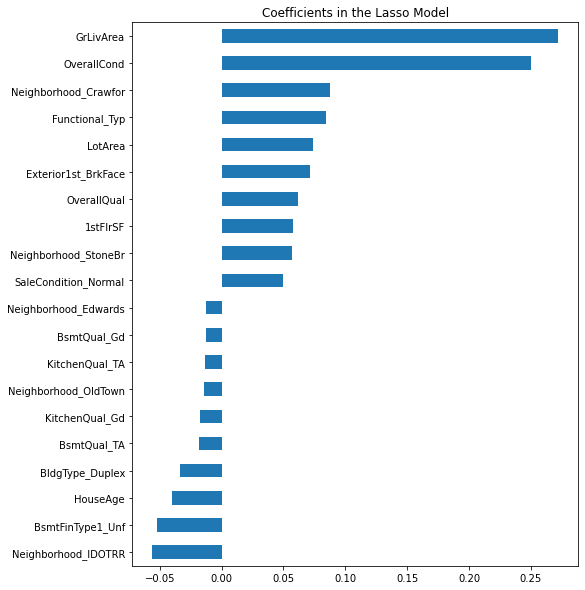

In [139]:
plt.rcParams['figure.figsize'] = (8.0, 10.0)
imp_coef_l1.plot(kind = "barh")
plt.title("Coefficients in the Lasso Model")

# Thus the 20 most important predictor variables are

1. **GrLivArea**: Above grade (ground) living area square feet
2. **OverallCond**: Rates the overall condition of the house
3. **Neighborhood_Crawfor**: Physical locations within Ames city limits is Crawford
4. **Functional_Typ**: Home functionality (Assume typical unless deductions are warranted) is Typical Functionality
5. **LotArea**: Lot size in square feet
6. **Exterior1st_BrkFace**: Exterior covering on house is Brick Face
7. **OverallQual**: Rates the overall material and finish of the house
8. **1stFlrSF**: First Floor square feet
9. **Neighborhood_StoneBr**: Physical locations within Ames city limits is Stone Brook
10. **SaleCondition_Normal**: Condition of sale is Normal
11. **Neighborhood_Edwards**: Physical locations within Ames city limits is Edwards
12. **BsmtQual_Gd**: The height of the basement is Good (90-99 inches)
13. **KitchenQual_TA**: Kitchen quality is Typical/Average
14. **Neighborhood_OldTown**: Physical locations within Ames city limits is Old Town
15. **KitchenQual_Gd**: Kitchen quality is Good
16. **BsmtQual_TA**: Evaluates the height of the basement is Typical (80-89 inches)
17. **BldgType_Duplx**: Type of dwelling is Duplex
18. **HouseAge** : YrSold: Year Sold (YYYY) - YearBuilt: Original construction date
19. **BsmtFinType1_Unf**: Rating of basement finished area is Unfinished
20. **Neighborhood_IDOTRR**: Physical locations within Ames city limits is Iowa DOT and Rail Road











* **





### END